In [ ]:
%matplotlib inline 
import time
import numpy as np
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import os
from os import listdir, makedirs, getcwd, remove
from os.path import isfile, join, abspath, exists, isdir, expanduser
from PIL import Image
import torch
from torch.optim import lr_scheduler
from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader, Subset
import torchvision
from torchvision import transforms, datasets, models
from torchvision.transforms import ToTensor
import cv2
from sklearn.model_selection import train_test_split
from torchvision.datasets import ImageFolder


from tqdm.auto import tqdm

In [ ]:
import torch, torchvision

from pathlib import Path
import numpy as np
import cv2
import pandas as pd
from tqdm import tqdm
import PIL.Image as Image
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from matplotlib.ticker import MaxNLocator
from torch.optim import lr_scheduler
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
from glob import glob
import shutil
from collections import defaultdict

from torch import nn, optim

import torch.nn.functional as F
import torchvision.transforms as T
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from torchvision import models

%matplotlib inline
%config InlineBackend.figure_format='retina'

sns.set(style='whitegrid', palette='muted', font_scale=1.2)

HAPPY_COLORS_PALETTE = ["#01BEFE", "#FFDD00", "#FF7D00", "#FF006D", "#ADFF02", "#8F00FF"]

sns.set_palette(sns.color_palette(HAPPY_COLORS_PALETTE))

rcParams['figure.figsize'] = 12, 8

RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [ ]:
# Resizing the images to 30x30x3
IMG_HEIGHT = 224
IMG_WIDTH = 244
channels = 3

In [ ]:
from torch.utils.data import random_split
from collections import Counter
mean = [0.3374, 0.3096, 0.3209]
std = [0.2723, 0.2628, 0.2723]
transform = transforms.Compose([
            transforms.Resize((IMG_HEIGHT,IMG_WIDTH)),
            transforms.ToTensor(),
            # transforms.Normalize(mean,std)
            ])
transform2 = transforms.Compose([
            transforms.Resize((IMG_HEIGHT,IMG_WIDTH)),
            transforms.ToTensor(),
            # transforms.Normalize(mean,std)
            ])

In [ ]:
def make_weights_for_balanced_classes(images, nclasses):
    n_images = len(images)
    count_per_class = [0] * nclasses
    for _, image_class in images:
        count_per_class[image_class] += 1
    weight_per_class = [0.] * nclasses
    for i in range(nclasses):
        weight_per_class[i] = float(n_images) / float(count_per_class[i])
    weights = [0] * n_images
    for idx, (image, image_class) in enumerate(images):
        weights[idx] = weight_per_class[image_class]
    return weights

In [ ]:
# For unbalanced dataset we create a weighted sampler          
             
weights = make_weights_for_balanced_classes(train_ds, NUM_CATEGORIES)    
weights = torch.DoubleTensor(weights)                                       
# sampler = torch.utils.data.sampler.WeightedRandomSampler(weights, train_number[-1]*NUM_CATEGORIES, replacement = True) 
sampler = torch.utils.data.sampler.WeightedRandomSampler(weights, len(train_ds), replacement = True) 

NameError: name 'train_ds' is not defined

In [ ]:
d = torchvision.datasets.GTSRB(root= '.', split= 'train', transform = transform, download= True)
test_ds = torchvision.datasets.GTSRB(root= '.', split= 'test',transform = transform2, download= True)

In [ ]:


random_seed = 42
torch.manual_seed(random_seed);
val_size = int(0.2*len(d))
train_size = int(len(d)-val_size)
train_ds, val_ds = random_split(d, [train_size, val_size])


train_dl = torch.utils.data.DataLoader(
    train_ds, batch_size=8, num_workers=4,shuffle=True)

val_dl = torch.utils.data.DataLoader(
    val_ds, batch_size=16, shuffle=True, num_workers=4)


test_dl = torch.utils.data.DataLoader(test_ds,
    batch_size=32, shuffle=True, num_workers=4)

In [ ]:
def get_mean_and_std(dataloader):
    channels_sum, channels_squared_sum, num_batches = 0, 0, 0
    for data, _ in dataloader:
        # Mean over batch, height and width, but not over the channels
        channels_sum += torch.mean(data, dim=[0,2,3])
        channels_squared_sum += torch.mean(data**2, dim=[0,2,3])
        num_batches += 1
    
    mean = channels_sum / num_batches

    # std = sqrt(E[X^2] - (E[X])^2)
    std = (channels_squared_sum / num_batches - mean ** 2) ** 0.5

    return mean, std

In [ ]:
print(get_mean_and_std(test_dl))

KeyboardInterrupt: 

In [ ]:
from torchvision.utils import make_grid

def show_batch(dl):
    for images, labels in dl:
        fig, ax = plt.subplots(figsize=(28, 28))
        ax.set_xticks([]); ax.set_yticks([])
        # ax.imshow(make_grid(to_device(transforms.Normalize(-np.array(mean)/std, 1.0/np.array(std))(images),"cpu"), nrow=16).permute(1, 2, 0)) ##denormalize
        ax.imshow(make_grid(to_device(images,"cpu"), nrow=16).permute(1, 2, 0)) ##denormalize
        break
        

In [ ]:
# Define what device we are using
print("CUDA Available: ",torch.cuda.is_available())
device = torch.device("cuda" if (torch.cuda.is_available()) else "cpu")

def to_device(data,device):
  if isinstance(data,(list,tuple)):
    return [to_device(x,device) for x in data]
  return data.to(device, non_blocking=True)

class DeviceDataLoader(): #wrap a dataloader to move data to a device
  def __init__(self, dl, device): 
    self.dl = dl
    self.device = device

  def __iter__(self):
    for b in self.dl: 
      yield to_device(b, self.device)
 #yield a batch of data after moving it to a device

  def __len__(self):
    return len(self.dl) #number of batches

CUDA Available:  True


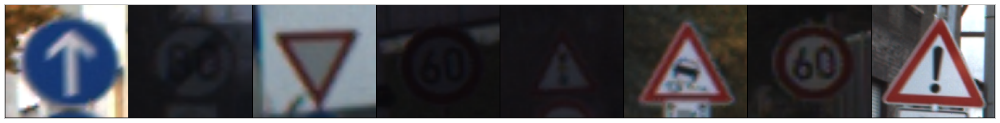

In [ ]:
show_batch(train_dl)

In [ ]:
import gc
def report_gpu():
   print(torch.cuda.list_gpu_processes())
   gc.collect()
   torch.cuda.empty_cache()

In [ ]:
import gc
gc.collect()
torch.cuda.empty_cache()

In [ ]:
def create_model(n_classes):
  model = models.resnet50(pretrained=True)

  n_features = model.fc.in_features
  model.fc = nn.Linear(n_features, n_classes)

  return model.to(device)

In [ ]:
base_model = create_model(43)

/home/roberto/anaconda3/envs/python38/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/roberto/anaconda3/envs/python38/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
def train_epoch(
  model, 
  data_loader, 
  loss_fn, 
  optimizer, 
  device, 
  scheduler, 
  n_examples
):
  model = model.train()

  losses = []
  correct_predictions = 0
  
  for inputs, labels in data_loader:
    inputs = inputs.to(device)
    labels = labels.to(device)

    outputs = model(inputs)

    _, preds = torch.max(outputs, dim=1)
    loss = loss_fn(outputs, labels)

    correct_predictions += torch.sum(preds == labels)
    losses.append(loss.item())

    loss.backward()
    optimizer.step()
    optimizer.zero_grad()

  # print('correct', correct_predictions, 'n_examples', n_examples, 'preds',len(preds), 'labels',len(labels))
  scheduler.step()

  return correct_predictions.double() / n_examples, np.mean(losses)

In [ ]:
def eval_model(model, data_loader, loss_fn, device, n_examples):
  model = model.eval()

  losses = []
  correct_predictions = 0

  with torch.no_grad():
    for inputs, labels in data_loader:
      inputs = inputs.to(device)
      labels = labels.to(device)

      outputs = model(inputs)

      _, preds = torch.max(outputs, dim=1)

      loss = loss_fn(outputs, labels)

      correct_predictions += torch.sum(preds == labels)
      # print('correct',correct_predictions,'total',n_examples,'outputs',len(outputs),'preds',len(preds),'labels',len(labels))
      losses.append(loss.item())
      # print('correct', correct_predictions,'total',n_examples,'preds',len(preds),'labels',len(labels))
  return correct_predictions.double() / n_examples, np.mean(losses)
     

In [ ]:
def train_model(model, data_loaders, dataset_sizes, device, n_epochs=3):
  optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.9)
  scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)
  loss_fn = nn.CrossEntropyLoss().to(device)

  history = defaultdict(list)
  best_accuracy = 0

  for epoch in range(n_epochs):

    print(f'Epoch {epoch + 1}/{n_epochs}')
    print('-' * 10)

    train_acc, train_loss = train_epoch(
      model,
      data_loaders['train'],    
      loss_fn, 
      optimizer, 
      device, 
      scheduler, 
      dataset_sizes['train']
    )

    print(f'Train loss {train_loss} accuracy {train_acc}')

    val_acc, val_loss = eval_model(
      model,
      data_loaders['val'],
      loss_fn,
      device,
      dataset_sizes['val']
    )

    print(f'Val   loss {val_loss} accuracy {val_acc}')
    print()

    history['train_acc'].append(train_acc)
    history['train_loss'].append(train_loss)
    history['val_acc'].append(val_acc)
    history['val_loss'].append(val_loss)

    if val_acc > best_accuracy:
      torch.save(model.state_dict(), 'best_model_state.bin')
      best_accuracy = val_acc

  print(f'Best val accuracy: {best_accuracy}')
  
  model.load_state_dict(torch.load('best_model_state.bin'))

  return model, history

In [ ]:
print(len(test_dl))

395


In [ ]:
data_loaders = {'test': test_dl,'train': train_dl,'val': val_dl}
dataset_sizes = {'test': len(test_dl)*16,'train': len(train_dl)*8,'val': len(val_dl)*16}

In [ ]:
dataset_sizes

{'test': 6320, 'train': 21312, 'val': 5328}

In [ ]:
base_model, history = train_model(base_model, data_loaders, dataset_sizes, device)

Epoch 1/3
----------
Train loss 0.6546926422486283 accuracy 0.8188344594594594
Val   loss 0.04838156239424137 accuracy 0.987424924924925

Epoch 2/3
----------
Train loss 0.053034778611131934 accuracy 0.9864395645645646
Val   loss 0.015900199573930417 accuracy 0.9943693693693694

Epoch 3/3
----------
Train loss 0.022354702756708072 accuracy 0.9951201201201201
Val   loss 0.01579363629719877 accuracy 0.9960585585585585

Best val accuracy: 0.9960585585585585


In [ ]:
# use_gpu = torch.cuda.is_available()
# resnet = models.resnet50(pretrained=True)
# inputs, labels = next(iter(train_dl))
# if use_gpu:
#     resnet = resnet.cuda()
#     inputs, labels = Variable(inputs.cuda()), Variable(labels.cuda())   
# else:
#     inputs, labels = Variable(inputs), Variable(labels)
# outputs = resnet(inputs)
# outputs.size()

torch.Size([8, 1000])

In [ ]:
# for param in resnet.parameters():
#   param.requires_grad = True

# # new final layer with 43 classes
# num_ftrs = resnet.fc.in_features
# resnet.fc = torch.nn.Linear(num_ftrs, 43)
# if use_gpu:
#     resnet = resnet.cuda()

# criterion = torch.nn.CrossEntropyLoss()
# optimizer = torch.optim.SGD(resnet.fc.parameters(), lr=0.01, nesterov=True, momentum=0.9)
# exp_lr_scheduler = lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

In [ ]:
def train_model(dataloders, model, criterion, optimizer, scheduler, num_epochs=3):
    since = time.time()
    use_gpu = torch.cuda.is_available()
    best_model_wts = model.state_dict()
    best_acc = 0.0
    dataset_sizes = {'train': len(dataloders['train'].dataset), 
                     'valid': len(dataloders['valid'].dataset)}

    for epoch in tqdm(range(num_epochs), desc = 'Epochs'):
        print(scheduler.get_last_lr())
        for phase in ['train', 'valid']:
            if phase == 'train':
                scheduler.step()
                model.train(True)
            else:
                model.train(False)

            running_loss = 0.0
            running_corrects = 0

            for inputs, labels in tqdm(dataloders[phase]):
                if use_gpu:
                    inputs, labels = Variable(inputs.cuda()), Variable(labels.cuda())
                else:
                    inputs, labels = Variable(inputs), Variable(labels)

                

                optimizer.zero_grad()

                outputs = model(inputs)
                _, preds = torch.max(outputs.data, 1)
                y = torch.nn.functional.one_hot(labels, num_classes = NUM_CATEGORIES).float()
                loss = criterion(outputs, y)
                if phase == 'train':
                    loss.backward()
                    optimizer.step()

                running_loss += loss.item()
                running_corrects += torch.sum(preds == labels.data)
            
            if phase == 'train':
                train_epoch_loss = running_loss / dataset_sizes[phase]
                train_epoch_acc = running_corrects / dataset_sizes[phase]
            else:
                valid_epoch_loss = running_loss / dataset_sizes[phase]
                valid_epoch_acc = running_corrects / dataset_sizes[phase]
                
            if phase == 'valid' and valid_epoch_acc > best_acc:
                best_acc = valid_epoch_acc
                best_model_wts = model.state_dict()

        print('Epoch [{}/{}] train loss: {:.4f} acc: {:.4f} ' 
              'valid loss: {:.4f} acc: {:.4f}'.format(
                epoch, num_epochs - 1,
                train_epoch_loss, train_epoch_acc, 
                valid_epoch_loss, valid_epoch_acc))
            
    print('Best val Acc: {:4f}'.format(best_acc))

    model.load_state_dict(best_model_wts)
    return model

In [ ]:
report_gpu()

GPU:0
process    1371199 uses      640.000 MB GPU memory


In [ ]:
# start_time = time.time()
# NUM_CATEGORIES = 43
# dloaders = {'train': train_dl, 'valid': val_dl}
# model = train_model(dloaders, resnet, criterion, optimizer, exp_lr_scheduler, num_epochs=100)
# print('Training time: {:10f} minutes'.format((time.time()-start_time)/60))

In [ ]:
def validation_step(model,batch):
    images, labels = batch
    images,labels = images.to(device), labels.to(device)
    out = model(images)
    out =out.to(device)

    loss = F.cross_entropy(out,labels)
    acc = accuracy(out, labels)
    return {'val_loss': loss.detach(), 'val_acc': acc}

def validation_epoch_end(model,outputs):
    batch_losses = [x['val_loss'] for x in outputs]
    epoch_loss = torch.stack(batch_losses).mean()
    batch_accs = [x['val_acc'] for x in outputs]
    epoch_acc = torch.stack(batch_accs).mean()
    return {'val_loss': epoch_loss.item(), 'val_acc': epoch_acc.item()}


In [ ]:
@torch.no_grad()

def evaluate(model, val_loader):
  model.eval()
  outputs = [validation_step(model,batch) for batch in tqdm(val_loader)]
  return validation_epoch_end(model,outputs)

def fit (epochs, lr, model, train_loader, val_loader, opt_func=torch.optim.SGD): 
  history = []
  optimizer = opt_func(model.parameters(), lr, weight_decay=(lr/epochs),momentum = 0.9)#1e-6
  for epoch in range(epochs):
    if (epoch % 10==0 and epoch > 5):
      optimizer = opt_func(model.parameters(), lr/10, weight_decay=(lr/epochs),momentum = 0.9)#1e-6
    model.train()
    train_losses = []
    #train
    for batch in train_loader:
      loss = model.training_step(batch)
      train_losses.append(loss)
      loss.backward()
      optimizer.step()
      optimizer.zero_grad()
    #validate
    result = evaluate(model,val_loader)
    result['train_loss'] = torch.stack(train_losses).mean().item()
    model.epoch_end(epoch,result)
    history.append(result)
  return history

In [ ]:
def accuracy(outputs, labels):
  _,preds = torch.max(outputs, dim=1)
  return torch.tensor(torch.sum(preds == labels).item() / len(preds))

In [ ]:
import torch.nn.functional as F
base_model.eval
result = evaluate(base_model, test_dl)
result


100%|██████████| 395/395 [00:29<00:00, 13.49it/s]


{'val_loss': 0.10336017608642578, 'val_acc': 0.9720367789268494}

In [ ]:
# torch.save(base_model.state_dict(), 'model_weights.pth')
















In [ ]:
base_model.load_state_dict(torch.load('model_weights.pth'))

<All keys matched successfully>

In [ ]:
base_model.eval
result = evaluate(base_model, test_dl)
result

100%|██████████| 395/395 [00:29<00:00, 13.24it/s]


{'val_loss': 0.10329794883728027, 'val_acc': 0.9720367789268494}

In [ ]:
def cw_l2_attack(model, images, labels, targeted=False, c=1e-4, kappa=0, max_iter=1000, learning_rate=0.01,im_start=False) :

    images = images.to(device)     
    labels = labels.to(device)

    # Define f-function
    def f(x,labels) :

        outputs = model(x).to(device)
        labels = labels.to(device)
        ou = outputs[0].to('cpu')
        la = labels.to('cpu')
        one_hot_labels = torch.eye(len(ou))[la].to(device)

        i, _ = torch.max((1-one_hot_labels)*outputs, dim=1)
        j = torch.masked_select(outputs, one_hot_labels.byte())
        
        # If targeted, optimize for making the other class most likely 
        if targeted :
            return torch.clamp(i-j, min=-kappa)
        
        # If untargeted, optimize for making the other class most likely 
        else :
            return torch.clamp(j-i, min=-kappa)
    if im_start:
        w=images
    else:
        w = torch.zeros_like(images, requires_grad=True).to(device)
    
    optimizer = optim.Adam([w], lr=learning_rate)

    prev = 1e10
    
    for step in range(max_iter) :

        a = 1/2*(nn.Tanh()(w) + 1)

        loss1 = nn.MSELoss(reduction='sum')(a, images)
        # loss1=0
        loss2 = torch.sum(c*f(a,labels))
        
        cost = loss1 + loss2

        optimizer.zero_grad()
        cost.backward()
        optimizer.step()

        # Early Stop when loss does not converge.
        if step % (max_iter//10) == 0 :
            if cost > prev :
                print('Attack Stopped due to CONVERGENCE....')
                return a,loss1.to('cpu').detach().numpy()
            prev = cost
        
        print('- Learning Progress : %2.2f %%        ' %((step+1)/max_iter*100), end='\r')

    attack_images = 1/2*(nn.Tanh()(w) + 1)
    images = images.to('cpu').detach()
    labels = labels.to('cpu').detach()
    return attack_images ,loss1.to('cpu').detach().numpy()

In [ ]:
def denormalize(imagess):
    mean = (0.5, 0.5, 0.5)
    std = (0.5, 0.5, 0.5)
    mean = np.array(mean)
    std = np.array(std)
    imagess = imagess * std[:, None, None] + mean[:, None, None]
    return imagess

In [ ]:
classes_dic = { 0:'Speed limit (20km/h)',
            1:'Speed limit (30km/h)', 
            2:'Speed limit (50km/h)', 
            3:'Speed limit (60km/h)', 
            4:'Speed limit (70km/h)', 
            5:'Speed limit (80km/h)', 
            6:'End of speed limit (80km/h)', 
            7:'Speed limit (100km/h)', 
            8:'Speed limit (120km/h)', 
            9:'No passing', 
            10:'No passing veh over 3.5 tons', 
            11:'Right-of-way at intersection', 
            12:'Priority road', 
            13:'Yield', 
            14:'Stop', 
            15:'No vehicles', 
            16:'Veh > 3.5 tons prohibited', 
            17:'No entry', 
            18:'General caution', 
            19:'Dangerous curve left', 
            20:'Dangerous curve right', 
            21:'Double curve', 
            22:'Bumpy road', 
            23:'Slippery road', 
            24:'Road narrows on the right', 
            25:'Road work', 
            26:'Traffic signals', 
            27:'Pedestrians', 
            28:'Children crossing', 
            29:'Bicycles crossing', 
            30:'Beware of ice/snow',
            31:'Wild animals crossing', 
            32:'End speed + passing limits', 
            33:'Turn right ahead', 
            34:'Turn left ahead', 
            35:'Ahead only', 
            36:'Go straight or right', 
            37:'Go straight or left', 
            38:'Keep right', 
            39:'Keep left', 
            40:'Roundabout mandatory', 
            41:'End of no passing', 
            42:'End no passing veh > 3.5 tons' }
lbls= [classes_dic[i] for i in range(43)]

In [ ]:
def visualize(images, adversarials, reals, labels, predicted, modiff, number,target=-1,save=""):
    # adversarials = adversarials + images
    # images = torch.clamp(images,0,1)
    # adversarials = torch.clamp(adversarials,0,1)
    # images = images.cpu().detach().numpy()
    # adversarials = adversarials.cpu().detach().numpy()
    # modiff = modiff.cpu().detach().numpy()
    #check if the tensor is in cuda or cpu
    if(torch.is_tensor(images)):
      images = images.cpu().detach().numpy()

    if(torch.is_tensor(adversarials)):
      adversarials = adversarials.cpu().detach().numpy()

    if(torch.is_tensor(modiff)):
      modiff = modiff.cpu().detach().numpy()

    if(torch.is_tensor(labels)):
      labels = labels.cpu().detach().numpy()

    if(torch.is_tensor(reals)):
      reals = reals.cpu().detach().numpy()

    if(torch.is_tensor(predicted)):
      predicted = predicted.cpu().detach().numpy()


    images = np.transpose(images, [0, 2, 3, 1])
    adversarials = np.transpose(adversarials, [0, 2, 3, 1])
    modiff = np.transpose(modiff, [0, 2, 3, 1])
    # adversarials = np.round(adversarials*255).astype(int)
    # images = np.round(images*255).astype(int)

    if(number>0):
      fig, axes = plt.subplots(3, number, figsize=(5*number, 12))
      count = i = j = 0
      
      while count != number and i<len(labels):
        if(target<0):
          while (labels[i]!=reals[i] or predicted[i]==reals[i]) and i<len(labels)-1:
            i+=1
          if((labels[i]!=reals[i] or predicted[i]==labels[i])):
            break
        else:
          while (labels[i]!=reals[i] or predicted[i]==reals[i] or predicted[i]!=target) and i<len(labels)-1:
            i+=1
          if(labels[i]!=reals[i] or predicted[i]==labels[i]or predicted[i]!=target):
            break
        
        if number>1:
          count+=1
          axes[0, j].imshow(images[i])
          axes[1, j].imshow(adversarials[i])
          axes[2, j].imshow(modiff[i])
          axes[0, j].set_title("Original: {}".format(lbls[labels[i]]))
          axes[1, j].set_title("Adversarial: {}".format(lbls[predicted[i]]))
          axes[2, j].set_title("modiff: ")
          axes[0, j].axis('off')
          axes[1, j].axis('off')
          axes[2, j].axis('off')
          i+=1
          j+=1
        else:
          count+=1
          axes[0].imshow(images[i])
          axes[1].imshow(adversarials[i])
          axes[2].imshow(modiff[i])
          axes[0].set_title("Original: {}".format(lbls[labels[i]]))
          axes[1].set_title("Adversarial: {}".format(lbls[predicted[i]]))
          axes[2].set_title("modiff: ")
          axes[0].axis('off')
          axes[1].axis('off')
          axes[2].axis('off')
      
      if save!="":
        plt.savefig('./results/C&W_L2_trafic_'+save+'.pdf',format='pdf',bbox_inches='tight')
      plt.show()

In [ ]:
def untargeted(model,c=2,im_start=False): #if im_start = true the optimization will start with the original image instead of random noise, so it wont have into account the c, the results will be a modification of all the pixels resulting on a grayish image, but the attack success rate is low, a 35-40% 
  print("Attack Image & predict label")
  model.eval()
  misclassified = to_count = total = correct = 0
  aux=0
  perturbed_images = []
  normal_images = []
  perturbed_labels = []
  predicted_labels = []
  normal_labels = []
  differences = []
  l=0
  for images, labels in test_dl:
      report_gpu()
      aux+=1
      iter_vis=0
      images = images.to(device)
      p_labels  = torch.max(model(images).data, 1)[1].to(device)

      images2,loss = cw_l2_attack(model, images, p_labels, targeted = False, c=c,im_start=im_start )
      
      labels = to_device(labels, device)
      outputs = model(images2)

      _, predicted = torch.max(outputs.data, 1)
      # set_trace()
      total += len(images)
      for i in range(len(predicted)):
        if p_labels[i]==labels[i]:
          to_count +=1
          if p_labels[i]!=predicted[i]:
            iter_vis+=1
            misclassified+=1
          else:
            correct += 1
      
      l+=loss
      
      A = (images2-images)
      transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
      A+=0.5

      # print(len(labels), len(p_labels), len(predicted))
      number = min(18,iter_vis)
      # visualize(images,images2, labels, p_labels, predicted,A, number)
      # if(aux%10==0):
      # visualize(images,images2, labels, p_labels, predicted,A, number, save=""+str(c)+"_untargeted")
      images2 = images2.cpu().detach().numpy()
      images = images.cpu().detach().numpy()
      p_labels = p_labels.cpu().detach().numpy()
      predicted = predicted.cpu().detach().numpy()
      labels = labels.cpu().detach().numpy()
      A = A.cpu().detach().numpy()

      
      perturbed_images.append(images2)
      normal_images.append(images)
      perturbed_labels.append(p_labels)
      predicted_labels.append(predicted)
      normal_labels.append(labels)
      differences.append(A)
      print('Correctamente etiquetados: ', to_count ,'Misclassified: ', misclassified, 'Correct: ', correct, 'Total: ',total, 'Incorrectos: ', total-to_count)
      report_gpu()
      if total > 1000:
        break
  print('Correctamente etiquetados: ', to_count ,'Misclassified: ', misclassified, 'Correct: ', correct, 'Total: ',total, 'Incorrectos: ', total-to_count)
  visualize(np.concatenate(normal_images),np.concatenate(perturbed_images), np.concatenate(normal_labels), np.concatenate(perturbed_labels), np.concatenate(predicted_labels),np.concatenate(differences), 5, save=""+str(c)+"_untargeted")
  A_sr =  misclassified / to_count
  P_sr = correct / total
  print('Accuracy of the network on the', to_count,' test images: %d %%' % (100 * A_sr))
  l /= len(test_dl)
  print('Loss: ', l)
  return misclassified, correct,l

In [ ]:
import torch.optim as optim
from torch import nn

In [ ]:
import os
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:128"

In [ ]:
report_gpu()


GPU:0
process    1371199 uses     1752.000 MB GPU memory


  0%|          | 0/3 [00:00<?, ?it/s]

c=  10
Attack Image & predict label
GPU:0
process    1135074 uses     1306.000 MB GPU memory


<ipython-input-76-8eba8c3bc789>:16: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/IndexingUtils.h:27.)
  j = torch.masked_select(outputs, one_hot_labels.byte())
/home/roberto/anaconda3/envs/python38/lib/python3.8/site-packages/torch/autograd/__init__.py:200: UserWarning: masked_scatter_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/cuda/IndexKernel.cpp:73.)
  Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Correctamente etiquetados:  32 Misclassified:  31 Correct:  1 Total:  32 Incorrectos:  0
GPU:0
process    1135074 uses     4568.000 MB GPU memory
GPU:0
process    1135074 uses     4310.000 MB GPU memory
Correctamente etiquetados:  64 Misclassified:  63 Correct:  1 Total:  64 Incorrectos:  0
GPU:0
process    1135074 uses     7666.000 MB GPU memory
GPU:0
process    1135074 uses     4850.000 MB GPU memory
Correctamente etiquetados:  94 Misclassified:  92 Correct:  2 Total:  96 Incorrectos:  2
GPU:0
process    1135074 uses     7674.000 MB GPU memory
GPU:0
process    1135074 uses     4446.000 MB GPU memory
Correctamente etiquetados:  126 Misclassified:  122 Correct:  4 Total:  128 Incorrectos:  2
GPU:0
process    1135074 uses     7628.000 MB GPU memory
GPU:0
process    1135074 uses     5154.000 MB GPU memory
Correctamente etiquetados:  158 Misclassified:  153 Correct:  5 Total:  160 Incorrectos:  2
GPU:0
process    1135074 uses     7664.000 MB GPU memory
GPU:0
process    1135074 uses     47

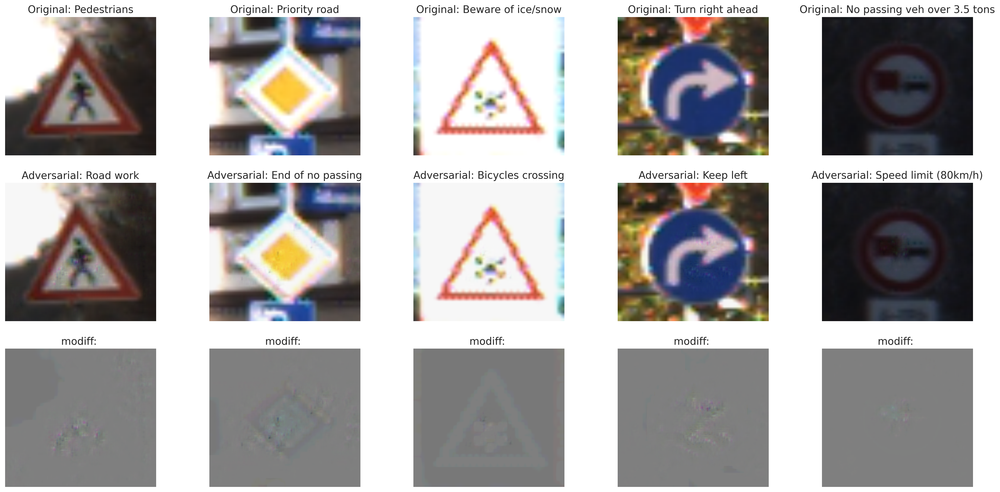

 33%|███▎      | 1/3 [1:56:08<3:52:16, 6968.07s/it]

Accuracy of the network on the 995  test images: 96 %
Loss:  34.25709668895866
c=  100
Attack Image & predict label
GPU:0
process    1135074 uses     6494.000 MB GPU memory


<ipython-input-76-8eba8c3bc789>:16: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/IndexingUtils.h:27.)
  j = torch.masked_select(outputs, one_hot_labels.byte())
/home/roberto/anaconda3/envs/python38/lib/python3.8/site-packages/torch/autograd/__init__.py:200: UserWarning: masked_scatter_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/cuda/IndexKernel.cpp:73.)
  Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Correctamente etiquetados:  32 Misclassified:  32 Correct:  0 Total:  32 Incorrectos:  0
GPU:0
process    1135074 uses     4608.000 MB GPU memory
GPU:0
process    1135074 uses     4350.000 MB GPU memory
Attack Stopped due to CONVERGENCE....
Correctamente etiquetados:  63 Misclassified:  63 Correct:  0 Total:  64 Incorrectos:  1
GPU:0
process    1135074 uses     7684.000 MB GPU memory
GPU:0
process    1135074 uses     4882.000 MB GPU memory
Correctamente etiquetados:  93 Misclassified:  93 Correct:  0 Total:  96 Incorrectos:  3
GPU:0
process    1135074 uses     7654.000 MB GPU memory
GPU:0
process    1135074 uses     4502.000 MB GPU memory
Correctamente etiquetados:  124 Misclassified:  124 Correct:  0 Total:  128 Incorrectos:  4
GPU:0
process    1135074 uses     7672.000 MB GPU memory
GPU:0
process    1135074 uses     5358.000 MB GPU memory
Correctamente etiquetados:  155 Misclassified:  155 Correct:  0 Total:  160 Incorrectos:  5
GPU:0
process    1135074 uses     7646.000 MB GPU memor

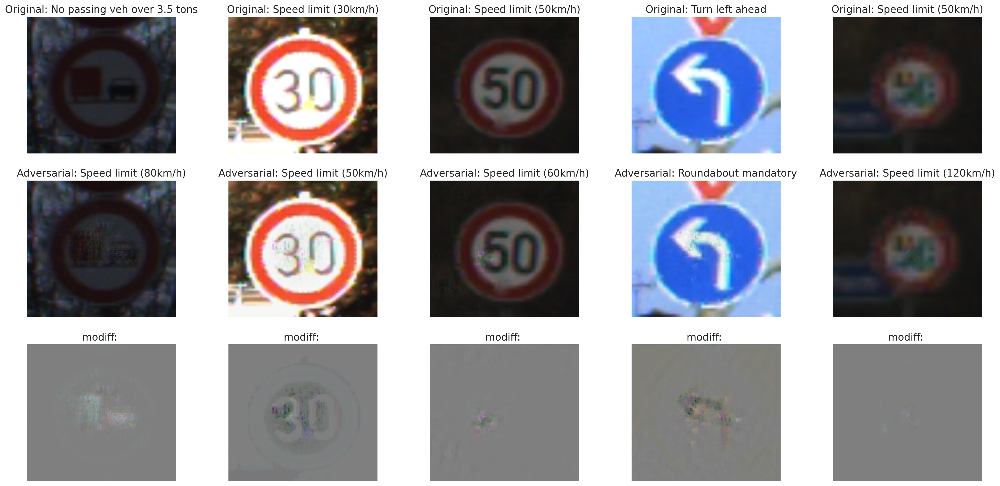

 67%|██████▋   | 2/3 [3:51:27<1:55:39, 6939.61s/it]

Accuracy of the network on the 994  test images: 99 %
Loss:  73.75881594887262
c=  1000
Attack Image & predict label
GPU:0
process    1135074 uses     6526.000 MB GPU memory


<ipython-input-76-8eba8c3bc789>:16: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/IndexingUtils.h:27.)
  j = torch.masked_select(outputs, one_hot_labels.byte())
/home/roberto/anaconda3/envs/python38/lib/python3.8/site-packages/torch/autograd/__init__.py:200: UserWarning: masked_scatter_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/cuda/IndexKernel.cpp:73.)
  Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Correctamente etiquetados:  31 Misclassified:  31 Correct:  0 Total:  32 Incorrectos:  1
GPU:0
process    1135074 uses     4608.000 MB GPU memory
GPU:0
process    1135074 uses     4350.000 MB GPU memory
Correctamente etiquetados:  61 Misclassified:  61 Correct:  0 Total:  64 Incorrectos:  3
GPU:0
process    1135074 uses     7684.000 MB GPU memory
GPU:0
process    1135074 uses     4882.000 MB GPU memory
Correctamente etiquetados:  93 Misclassified:  93 Correct:  0 Total:  96 Incorrectos:  3
GPU:0
process    1135074 uses     7666.000 MB GPU memory
GPU:0
process    1135074 uses     4500.000 MB GPU memory
Correctamente etiquetados:  124 Misclassified:  124 Correct:  0 Total:  128 Incorrectos:  4
GPU:0
process    1135074 uses     7652.000 MB GPU memory
GPU:0
process    1135074 uses     5050.000 MB GPU memory
Correctamente etiquetados:  155 Misclassified:  155 Correct:  0 Total:  160 Incorrectos:  5
GPU:0
process    1135074 uses     7696.000 MB GPU memory
GPU:0
process    1135074 uses     47

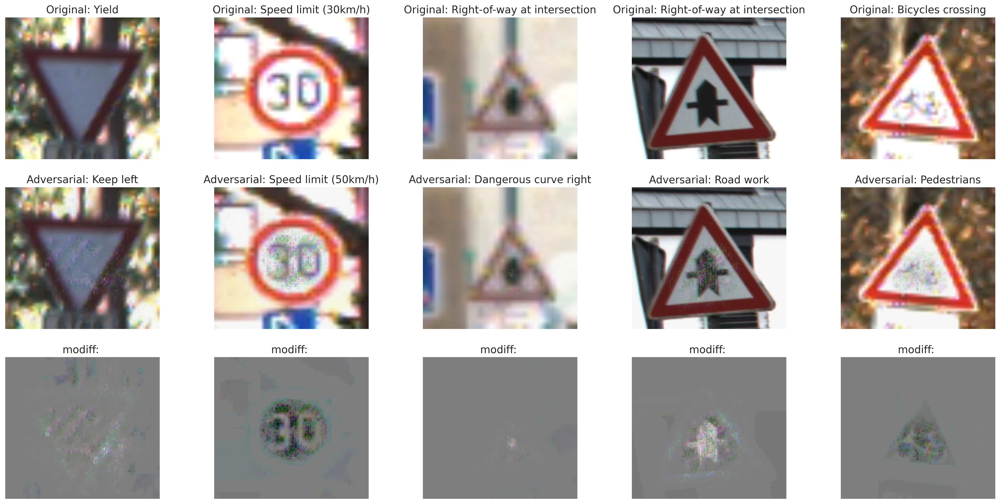

100%|██████████| 3/3 [5:47:49<00:00, 6956.39s/it]  

Accuracy of the network on the 985  test images: 99 %
Loss:  427.22737836234177


In [ ]:
import csv
v_c = [10,100,1000]
acc = []
l = []
row=[]
for c in tqdm(v_c):
  print("c= ",c)
  m,c,loss=untargeted(base_model,c,False)
  acc.append(m/(m+c))
  l.append(loss)
  row.append([c,m,m/(m+c),loss])
  with open('results.csv', 'w') as f:
    writer = csv.writer(f)
    writer.writerow(row)

In [ ]:
c=[]
m=[]
atacc=[]
l=[]

with open('results2.csv', 'r') as f:
    reader = csv.reader(f)
    for row in reader:
        c.append(int(row[0]))
        m.append(int(row[1]))
        acc.append(float(row[2]))
        l.append(float(row[3]))
for x,y in zip(c,m):
    aux = y/(x+y)
    atacc.append(aux)



[0.03441295546558704, 0.3158974358974359, 0.7928205128205128, 0.9658291457286432, 0.9969818913480886, 0.9979695431472081]


In [ ]:
def plot_accuracies(c,acc,loss,save=''):
    aux = [r'$1 e-02$',r'$1 e-01$',r'$1 e+00$',r'$1 e+01$',r'$1 e+02$',r'$1 e+03$']#
    fig, ax = plt.subplots()


    ax.plot(range(len(c)),acc)
    ax.set_xlabel(r'$C$')
    # ax.xlabel(r'$C$')
    ax.set_xticks(range(len(c)),aux)
    ax.set_ylabel('Attack Success Rate')

    ax2 = ax.twinx()
    ax2.plot(range(len(c)),loss,color='red')
    ax2.set_ylabel('Mean adversarial example distance',color='red')

    # plt.title('Attack Success Rate vs. ' r'$C$')
    if save!="":
      plt.savefig('C&W_L2_'+save+'.pdf',format='pdf',bbox_inches='tight')
    plt.show()

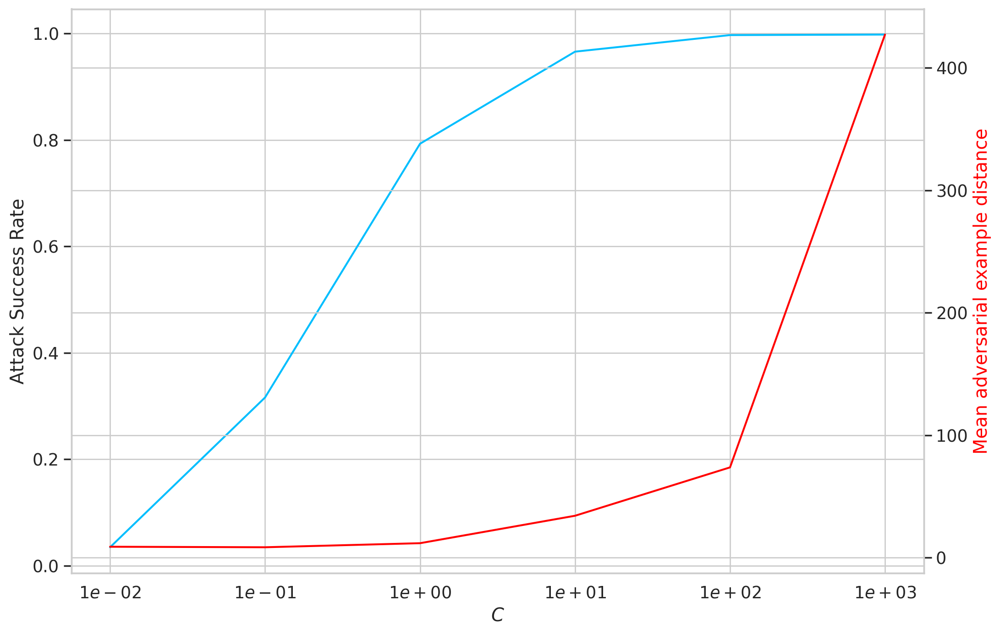

In [ ]:
plot_accuracies(c,atacc,l,save='untargeted')

In [ ]:
import gc
def report_gpu():
   gc.collect()
   torch.cuda.empty_cache()

In [ ]:
report_gpu()

In [ ]:
import gc
gc.collect()
torch.cuda.empty_cache()

In [ ]:
inputs=inputs.cpu()
labels=labels.cpu()
print(labels)
torch.cuda.empty_cache()

NameError: name 'inputs' is not defined

In [ ]:
gc.collect()
torch.cuda.empty_cache()

In [ ]:
def targeted(model,c=2,t=0,im_start=False): #if im_start = true the optimization will start with the original image instead of random noise, so it wont have into account the c, the results will be a modification of all the pixels resulting on a grayish image, but the attack success rate is low, a 35-40% 
    print("Attack Image & predict label")
    model.eval()
    misclassified = to_count = total = correct = 0
    aux=0
    perturbed_images = []
    normal_images = []
    perturbed_labels = []
    predicted_labels = []
    normal_labels = []
    differences = []
    l=0
    for images, labels in test_dl:
        report_gpu()
        aux+=1
        iter_vis=0
        images = images.to(device)
        p_labels  = torch.max(model(images).data, 1)[1].to(device)

        target = torch.full((images.shape[0],), t).to(device)

        images2,loss = cw_l2_attack(model, images, target, targeted = True, c=c,im_start=im_start )
        l+=loss
        labels = to_device(labels, device)
        outputs = model(images2)

        _, predicted = torch.max(outputs.data, 1)
        # set_trace()
        total += len(images)
        for i in range(len(predicted)):
            if p_labels[i]==labels[i]:
                if p_labels[i]!=t:
                    to_count +=1
                    if predicted[i]==t:
                        iter_vis+=1
                        misclassified+=1
                    else:
                        correct += 1

        A = (images2-images)
        transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
        A+=0.5

        # print(len(labels), len(p_labels), len(predicted))
        number = min(18,iter_vis)
        # visualize(images,images2, labels, p_labels, predicted,A, number)
        # if(aux%10==0):
        # visualize(images,images2, labels, p_labels, predicted,A, number, save=""+str(c)+"_untargeted")
        images2 = images2.cpu().detach().numpy()
        images = images.cpu().detach().numpy()
        p_labels = p_labels.cpu().detach().numpy()
        predicted = predicted.cpu().detach().numpy()
        labels = labels.cpu().detach().numpy()
        A = A.cpu().detach().numpy()

        perturbed_images.append(images2)
        normal_images.append(images)
        perturbed_labels.append(p_labels)
        predicted_labels.append(predicted)
        normal_labels.append(labels)
        differences.append(A)
        print('Correctamente etiquetados: ', to_count ,'Misclassified: ', misclassified, 'Correct: ', correct, 'Total: ',total, 'Incorrectos: ', total-to_count)
        report_gpu()
        if total > 1000:
            break
    print('Correctamente etiquetados: ', to_count ,'Misclassified: ', misclassified, 'Correct: ', correct, 'Total: ',total, 'Incorrectos: ', total-to_count)
    visualize(np.concatenate(normal_images),np.concatenate(perturbed_images), np.concatenate(normal_labels), np.concatenate(perturbed_labels), np.concatenate(predicted_labels),np.concatenate(differences), 5, save="targeted-"+str(t)+'c'+str(c))
    A_sr =  misclassified / to_count
    P_sr = correct / total
    print('Accuracy of the network on the', to_count,' test images: %d %%' % (100 * A_sr))
    l /= len(test_dl)
    print('Loss: ', l)
    return misclassified, correct,l

In [ ]:
row_t=[c_t,m_t,m_t/(m_t+c_t),loss_t]
row_t=[[953,16,0.016511867905056758,16.911682032331637],[4,237,0.2476489028213166,18.749666373337373]]

print(row_t)
with open('results.csv', 'w') as f:
        writer = csv.writer(f)
        writer.writerows(row_t)

[[953, 16, 0.016511867905056758, 16.911682032331637], [4, 237, 0.2476489028213166, 18.749666373337373]]


  0%|          | 0/4 [00:00<?, ?it/s]

c=  1
Attack Image & predict label


<ipython-input-32-8eba8c3bc789>:16: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/IndexingUtils.h:27.)
  j = torch.masked_select(outputs, one_hot_labels.byte())
/home/roberto/anaconda3/envs/python38/lib/python3.8/site-packages/torch/autograd/__init__.py:200: UserWarning: masked_scatter_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/cuda/IndexKernel.cpp:73.)
  Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Correctamente etiquetados:  29 Misclassified:  19 Correct:  10 Total:  32 Incorrectos:  3
Correctamente etiquetados:  59 Misclassified:  42 Correct:  17 Total:  64 Incorrectos:  5
Correctamente etiquetados:  91 Misclassified:  65 Correct:  26 Total:  96 Incorrectos:  5
Correctamente etiquetados:  121 Misclassified:  90 Correct:  31 Total:  128 Incorrectos:  7
Correctamente etiquetados:  151 Misclassified:  110 Correct:  41 Total:  160 Incorrectos:  9
Correctamente etiquetados:  181 Misclassified:  139 Correct:  42 Total:  192 Incorrectos:  11
Correctamente etiquetados:  213 Misclassified:  161 Correct:  52 Total:  224 Incorrectos:  11
Correctamente etiquetados:  241 Misclassified:  181 Correct:  60 Total:  256 Incorrectos:  15
Correctamente etiquetados:  270 Misclassified:  201 Correct:  69 Total:  288 Incorrectos:  18
Correctamente etiquetados:  300 Misclassified:  225 Correct:  75 Total:  320 Incorrectos:  20
Correctamente etiquetados:  330 Misclassified:  250 Correct:  80 Total:  35

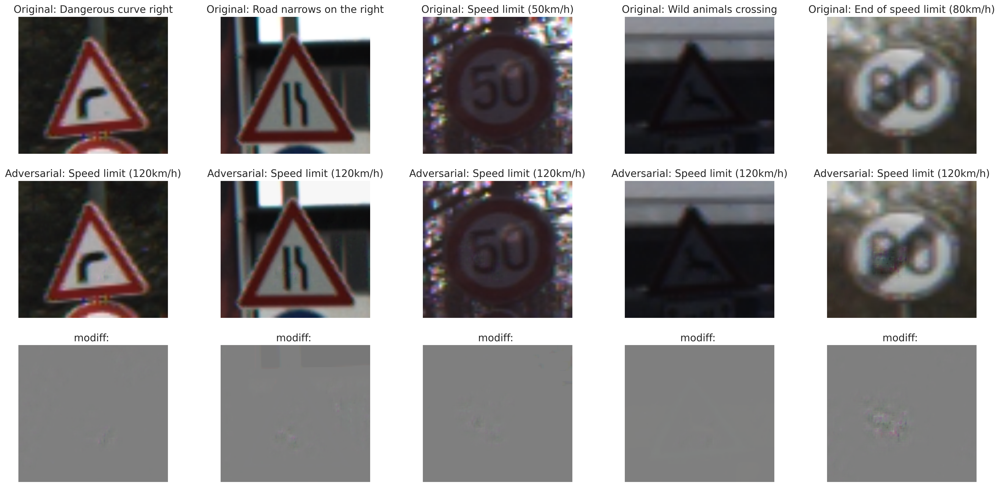

 25%|██▌       | 1/4 [1:59:21<5:58:05, 7161.98s/it]

Accuracy of the network on the 964  test images: 71 %
Loss:  25.527177139475377
c=  10
Attack Image & predict label


<ipython-input-32-8eba8c3bc789>:16: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/IndexingUtils.h:27.)
  j = torch.masked_select(outputs, one_hot_labels.byte())
/home/roberto/anaconda3/envs/python38/lib/python3.8/site-packages/torch/autograd/__init__.py:200: UserWarning: masked_scatter_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/cuda/IndexKernel.cpp:73.)
  Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Correctamente etiquetados:  30 Misclassified:  29 Correct:  1 Total:  32 Incorrectos:  2
Correctamente etiquetados:  60 Misclassified:  59 Correct:  1 Total:  64 Incorrectos:  4
Correctamente etiquetados:  90 Misclassified:  87 Correct:  3 Total:  96 Incorrectos:  6
Correctamente etiquetados:  119 Misclassified:  115 Correct:  4 Total:  128 Incorrectos:  9
Correctamente etiquetados:  149 Misclassified:  145 Correct:  4 Total:  160 Incorrectos:  11
Correctamente etiquetados:  179 Misclassified:  174 Correct:  5 Total:  192 Incorrectos:  13
Correctamente etiquetados:  209 Misclassified:  202 Correct:  7 Total:  224 Incorrectos:  15
Correctamente etiquetados:  239 Misclassified:  230 Correct:  9 Total:  256 Incorrectos:  17
Correctamente etiquetados:  270 Misclassified:  259 Correct:  11 Total:  288 Incorrectos:  18
Correctamente etiquetados:  302 Misclassified:  291 Correct:  11 Total:  320 Incorrectos:  18
Correctamente etiquetados:  331 Misclassified:  319 Correct:  12 Total:  352 Inco

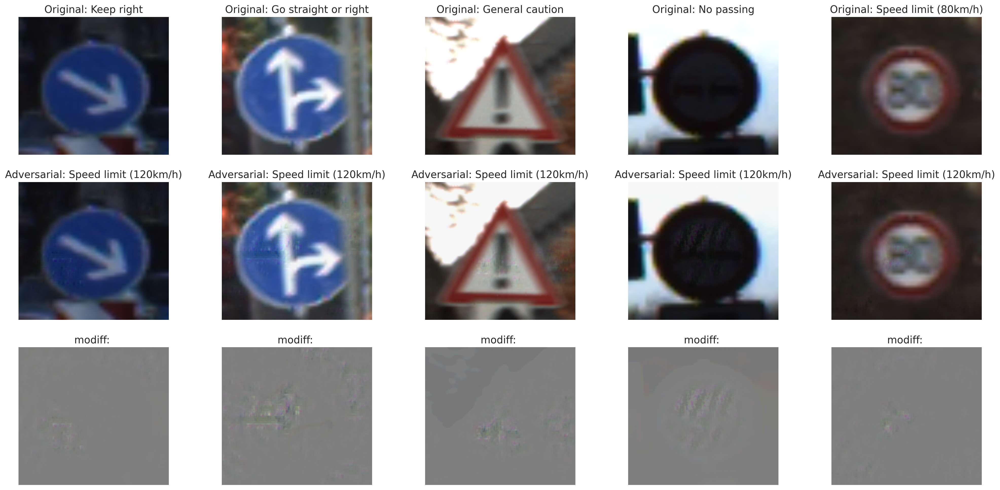

 50%|█████     | 2/4 [3:57:52<3:57:43, 7131.92s/it]

Accuracy of the network on the 962  test images: 96 %
Loss:  33.14480474930775
c=  100
Attack Image & predict label


<ipython-input-32-8eba8c3bc789>:16: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/IndexingUtils.h:27.)
  j = torch.masked_select(outputs, one_hot_labels.byte())
/home/roberto/anaconda3/envs/python38/lib/python3.8/site-packages/torch/autograd/__init__.py:200: UserWarning: masked_scatter_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/cuda/IndexKernel.cpp:73.)
  Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Correctamente etiquetados:  30 Misclassified:  30 Correct:  0 Total:  32 Incorrectos:  2
Correctamente etiquetados:  60 Misclassified:  60 Correct:  0 Total:  64 Incorrectos:  4
Correctamente etiquetados:  89 Misclassified:  89 Correct:  0 Total:  96 Incorrectos:  7
Correctamente etiquetados:  118 Misclassified:  117 Correct:  1 Total:  128 Incorrectos:  10
Correctamente etiquetados:  147 Misclassified:  146 Correct:  1 Total:  160 Incorrectos:  13
Correctamente etiquetados:  176 Misclassified:  175 Correct:  1 Total:  192 Incorrectos:  16
Correctamente etiquetados:  205 Misclassified:  204 Correct:  1 Total:  224 Incorrectos:  19
Correctamente etiquetados:  235 Misclassified:  234 Correct:  1 Total:  256 Incorrectos:  21
Attack Stopped due to CONVERGENCE....
Correctamente etiquetados:  261 Misclassified:  260 Correct:  1 Total:  288 Incorrectos:  27
Correctamente etiquetados:  291 Misclassified:  289 Correct:  2 Total:  320 Incorrectos:  29
Correctamente etiquetados:  316 Misclassifie

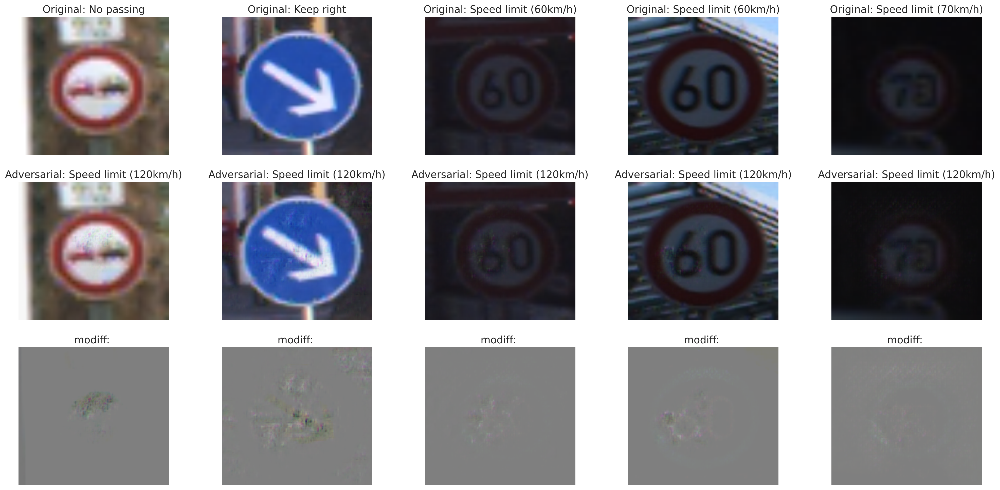

 75%|███████▌  | 3/4 [5:54:33<1:57:52, 7072.04s/it]

Accuracy of the network on the 944  test images: 99 %
Loss:  94.26030335245254
c=  1000
Attack Image & predict label


<ipython-input-32-8eba8c3bc789>:16: UserWarning: indexing with dtype torch.uint8 is now deprecated, please use a dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/IndexingUtils.h:27.)
  j = torch.masked_select(outputs, one_hot_labels.byte())
/home/roberto/anaconda3/envs/python38/lib/python3.8/site-packages/torch/autograd/__init__.py:200: UserWarning: masked_scatter_ received a mask with dtype torch.uint8, this behavior is now deprecated,please use a mask with dtype torch.bool instead. (Triggered internally at /opt/conda/conda-bld/pytorch_1678402379298/work/aten/src/ATen/native/cuda/IndexKernel.cpp:73.)
  Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Correctamente etiquetados:  31 Misclassified:  31 Correct:  0 Total:  32 Incorrectos:  1
Correctamente etiquetados:  62 Misclassified:  61 Correct:  1 Total:  64 Incorrectos:  2
Correctamente etiquetados:  91 Misclassified:  90 Correct:  1 Total:  96 Incorrectos:  5
Correctamente etiquetados:  122 Misclassified:  121 Correct:  1 Total:  128 Incorrectos:  6
Correctamente etiquetados:  153 Misclassified:  152 Correct:  1 Total:  160 Incorrectos:  7
Correctamente etiquetados:  183 Misclassified:  182 Correct:  1 Total:  192 Incorrectos:  9
Correctamente etiquetados:  214 Misclassified:  213 Correct:  1 Total:  224 Incorrectos:  10
Correctamente etiquetados:  241 Misclassified:  240 Correct:  1 Total:  256 Incorrectos:  15
Correctamente etiquetados:  271 Misclassified:  270 Correct:  1 Total:  288 Incorrectos:  17
Correctamente etiquetados:  300 Misclassified:  299 Correct:  1 Total:  320 Incorrectos:  20
Correctamente etiquetados:  328 Misclassified:  327 Correct:  1 Total:  352 Incorrect

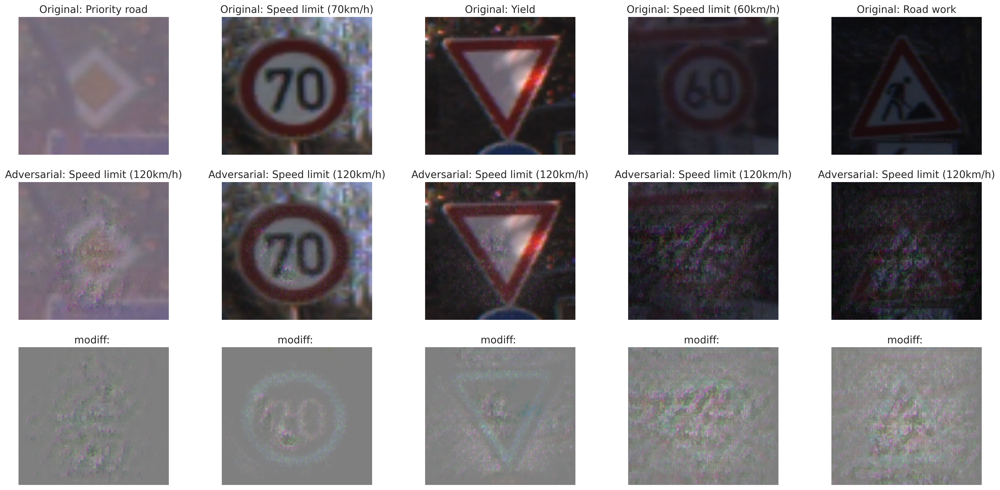

100%|██████████| 4/4 [7:52:11<00:00, 7082.99s/it]  

Accuracy of the network on the 962  test images: 99 %
Loss:  783.5206029964398


In [ ]:
import csv
v_c = [1,10,100,1000]

acc_t = []
l_t = []
row_t=[]
t=8
for c in tqdm(v_c):
    print("c= ",c)
    m_t,c_t,loss_t=targeted(base_model,c,t,False)
    acc_t.append(m_t/(m_t+c_t))
    l_t.append(loss_t)
    row_t.append([c_t,m_t,m_t/(m_t+c_t),loss_t])
    with open('results.csv', 'w') as f:
        writer = csv.writer(f)
        writer.writerows(row_t)

In [ ]:
c=[]
m=[]
atacc=[]
l=[]

with open('results.csv', 'r') as f:
    reader = csv.reader(f)
    for row in reader:
        c.append(int(row[0]))
        m.append(int(row[1]))
        atacc.append(float(row[2]))
        l.append(float(row[3]))



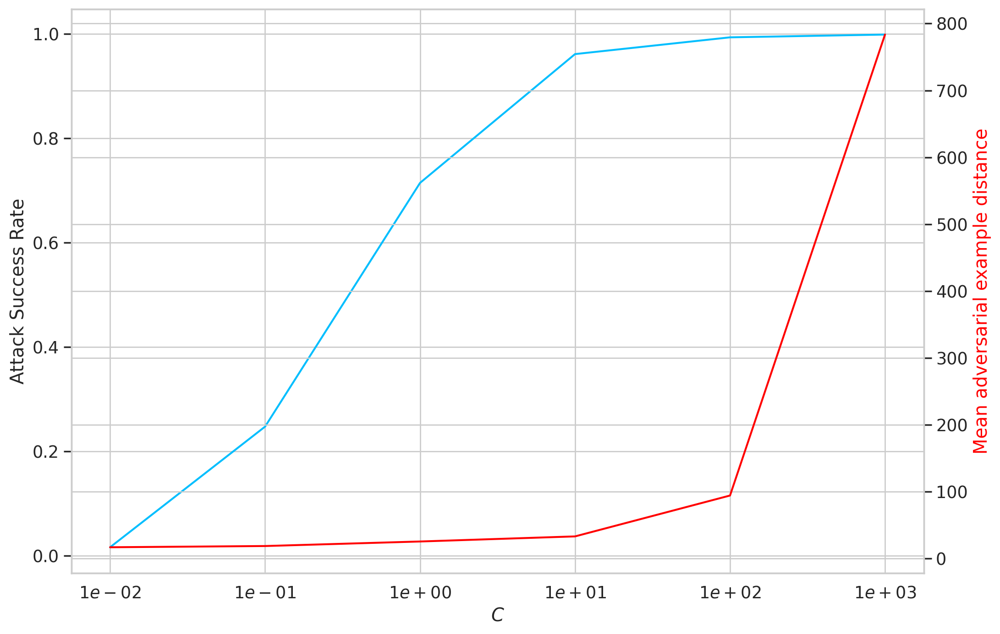

: 

In [ ]:
plot_accuracies(c,atacc,l,save='targeted')